100%|██████████| 170498071/170498071 [00:03<00:00, 43506516.28it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified
Train Epoch: 0 	Model: 0 	Training Loss: 7899.756829693494 	Temperature Strategy: fixed 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 1 	Training Loss: 7904.948563129396 	Temperature Strategy: fixed 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 2 	Training Loss: 7908.090995144661 	Temperature Strategy: linear_increase 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 3 	Training Loss: 7904.5896264586 	Temperature Strategy: linear_decrease 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 4 	Training Loss: 7892.637266973706 	Temperature Strategy: exp_increase 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 5 	Training Loss: 7883.066538622922 	Temperature Strategy: exp_decrease 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 6 	Training Loss: 7923.607587965553 	Temperature Strategy: fixed 	tau_1: 1.0 	tau_2: 1.0
Train Epoch: 0 	Model: 7 	Training Loss: 7944.3396926450605 	Temperature Strategy: linear_incre

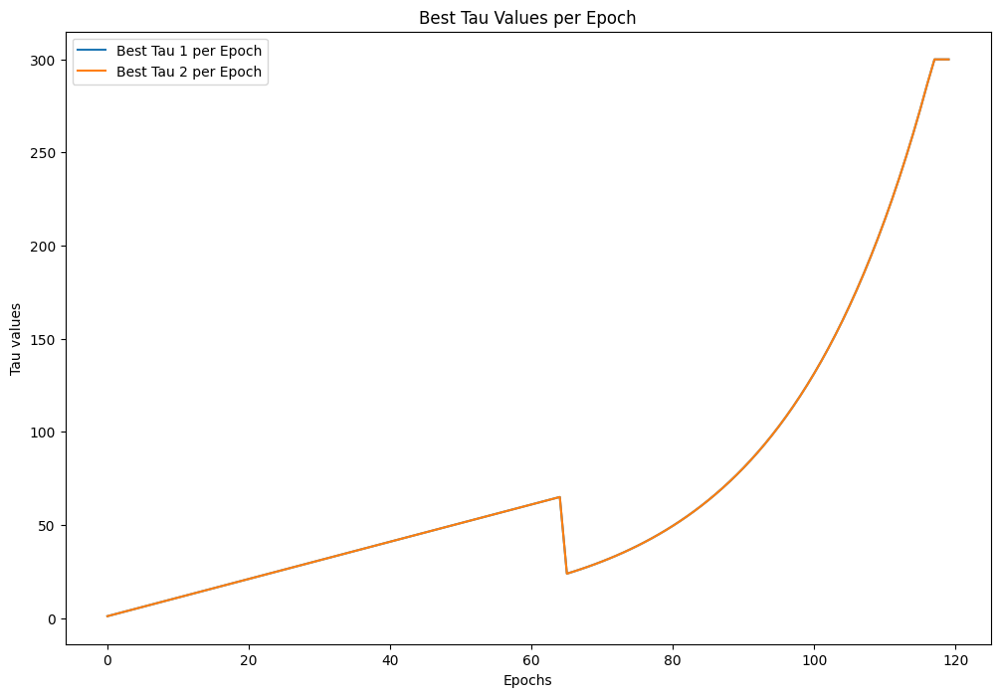

In [1]:
# Our proposed model using linear increasing tau on CIFAR-10
# The models are trained by using full dataset
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import copy
import numpy as np
import os
import torch.nn.functional as F
import torch.utils.data.dataloader as dataloader
import torch.optim as optim
from torch.utils.data import TensorDataset
from torch.autograd import Variable
from torchvision import transforms
from torchvision.datasets import CelebA
from torch import optim
from torch.utils import data as dataloader



# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')
SAVE_PATH = '/content/sample_data/best_model_CIFAR10_parallel_laptop1060.pth'


# Define constants
BATCH_SIZE = 128
Z_DIM = 300
LOG_INTERVAL = 50


# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss


# Initialize constants
initial_tau_1 = 1.0
initial_tau_2 = 1.0
NUM_EPOCHS = 120
LOG_INTERVAL = 50
NUM_MODELS = 11
LOSS_THRESHOLD = 0.0001

# Define temperature strategies
temp_strategies = ['fixed', 'linear_increase', 'linear_decrease', 'exp_increase', 'exp_decrease']
temp_strategies_extended = ['fixed'] + temp_strategies * ((NUM_MODELS - 1) // len(temp_strategies)) + temp_strategies[:((NUM_MODELS - 1) % len(temp_strategies))]
tau_min, tau_max = 0.001, 300
lin_increase, lin_decrease = 1.0, 0.01
exp_increase, exp_decrease = 1.05, 0.995
learning_rate = 0.01
patience_threshold = 5
patience_counter = [0 for _ in range(NUM_MODELS)]

# Ensure temp_strategies_extended has correct length
assert len(temp_strategies_extended) == NUM_MODELS, f"Expected {NUM_MODELS} strategies, got {len(temp_strategies_extended)}"

# Initialize models and optimizers
models = [GumbelSoftmaxVAE().to(device) for _ in range(NUM_MODELS)]
optimizers = [optim.Adam(model.parameters(), lr=1e-3) for model in models]

# Initialize variables to record the best tau values and global loss
best_tau_per_epoch_1 = []
best_tau_per_epoch_2 = []
best_global_loss = float('inf')  # Initialize the best global loss with infinity

for epoch in range(NUM_EPOCHS):
    losses = []
    best_reconstruction = None
    original_images = None

    for i in range(NUM_MODELS):
        model = models[i]
        temp_strategy = temp_strategies_extended[i]

        if temp_strategy == 'fixed':
            model.tau_1 = nn.Parameter(torch.tensor(float(initial_tau_1), dtype=torch.float32), requires_grad=True)
            model.tau_2 = nn.Parameter(torch.tensor(float(initial_tau_2), dtype=torch.float32), requires_grad=True)
        elif temp_strategy == 'linear_increase':
            model.tau_1 = nn.Parameter(torch.tensor(float(min(initial_tau_1 + epoch * lin_increase, tau_max)), dtype=torch.float32), requires_grad=True)
            model.tau_2 = nn.Parameter(torch.tensor(float(min(initial_tau_2 + epoch * lin_increase, tau_max)), dtype=torch.float32), requires_grad=True)
        elif temp_strategy == 'linear_decrease':
            model.tau_1 = nn.Parameter(torch.tensor(float(max(initial_tau_1 - epoch * lin_decrease, tau_min)), dtype=torch.float32), requires_grad=True)
            model.tau_2 = nn.Parameter(torch.tensor(float(max(initial_tau_2 - epoch * lin_decrease, tau_min)), dtype=torch.float32), requires_grad=True)
        elif temp_strategy == 'exp_increase':
            model.tau_1 = nn.Parameter(torch.tensor(float(min(initial_tau_1 * (exp_increase ** epoch), tau_max)), dtype=torch.float32), requires_grad=True)
            model.tau_2 = nn.Parameter(torch.tensor(float(min(initial_tau_2 * (exp_increase ** epoch), tau_max)), dtype=torch.float32), requires_grad=True)
        elif temp_strategy == 'exp_decrease':
            model.tau_1 = nn.Parameter(torch.tensor(float(max(initial_tau_1 * (exp_decrease ** epoch), tau_min)), dtype=torch.float32), requires_grad=True)
            model.tau_2 = nn.Parameter(torch.tensor(float(max(initial_tau_2 * (exp_decrease ** epoch), tau_min)), dtype=torch.float32), requires_grad=True)

        epoch_loss = 0.0

        for batch_idx, (data, _) in enumerate(train_loader):
            data = data.to(device)
            optimizers[i].zero_grad()
            recon_batch, logits_z1, logits_z2, z1, z2 = model(data)
            loss = model.gumbel_softmax_loss_function(recon_batch, data, logits_z1, logits_z2, z1, z2)
            loss.backward()
            optimizers[i].step()
            epoch_loss += loss.item()

            if epoch_loss < LOSS_THRESHOLD and (best_reconstruction is None or loss.item() < min(losses)):
                best_reconstruction = recon_batch
                original_images = data

        epoch_loss /= len(train_loader)
        losses.append(epoch_loss)
        print(f'Train Epoch: {epoch} \tModel: {i} \tTraining Loss: {epoch_loss} \tTemperature Strategy: {temp_strategy} \ttau_1: {model.tau_1.item()} \ttau_2: {model.tau_2.item()}')

    best_model_idx = np.argmin(losses)
    best_loss = losses[best_model_idx]

    # Check if the current best loss is better than the global best loss
    if best_loss < best_global_loss:
        best_global_loss = best_loss
        best_model_state_dict = copy.deepcopy(models[best_model_idx].state_dict())
        torch.save(models[best_model_idx].state_dict(), SAVE_PATH)  # Save the best model
        print(f'Best model saved with index: {best_model_idx} and loss: {best_loss}')

    for i in range(NUM_MODELS):
        if i != best_model_idx:
            if losses[i] > best_loss:
                patience_counter[i] += 1
                if patience_counter[i] >= patience_threshold:
                    delta_tau = learning_rate * (losses[i] - best_loss)  # positive item
                    models[i].tau_1 = nn.Parameter(torch.tensor(float(min(models[i].tau_1.item() + delta_tau, tau_max)), dtype=torch.float32), requires_grad=True)
                    models[i].tau_2 = nn.Parameter(torch.tensor(float(min(models[i].tau_2.item() + delta_tau, tau_max)), dtype=torch.float32), requires_grad=True)
                    patience_counter[i] = 0

    best_tau_per_epoch_1.append(models[best_model_idx].tau_1.item())
    best_tau_per_epoch_2.append(models[best_model_idx].tau_2.item())

    print(f'Epoch: {epoch} \tBest Model Index: {best_model_idx} \tBest Temperature Strategy: {temp_strategies_extended[best_model_idx]} \tBest tau_1: {models[best_model_idx].tau_1.item()} \tBest tau_2: {models[best_model_idx].tau_2.item()}')

    if best_reconstruction is not None and original_images is not None:
        plot_images(original_images.cpu(), best_reconstruction.cpu())

# Output the best tau for each epoch
for epoch, (tau_1, tau_2) in enumerate(zip(best_tau_per_epoch_1, best_tau_per_epoch_2)):
    print(f"Epoch: {epoch}, Best Tau 1: {tau_1}, Best Tau 2: {tau_2}")

# Plot the best_tau_per_epoch
plt.figure(figsize=(12, 8))
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_1, label='Best Tau 1 per Epoch')
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_2, label='Best Tau 2 per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Tau values')
plt.title('Best Tau Values per Epoch')
plt.legend()
plt.show()

In [2]:
#Print best model's tau_1 and tau_2
print(models[best_model_idx].tau_1)
print(models[best_model_idx].tau_2)

Parameter containing:
tensor(300., requires_grad=True)
Parameter containing:
tensor(300., requires_grad=True)


MSE Loss: 0.0014181623701006174


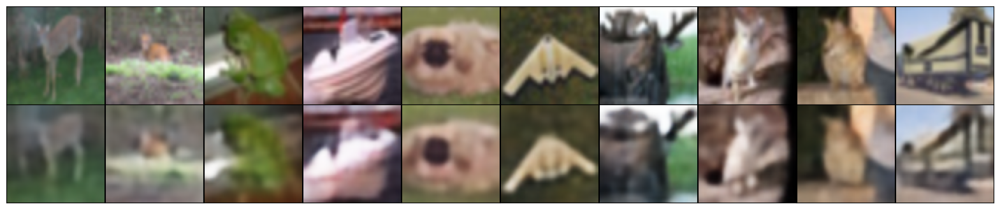

Pixel Error: 2.697857841849327%


In [3]:
# Test our proposed model's MSE on CIFAR-10
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()


data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Pass the images through the model
recon_batch, _, _, _, _ = models[best_model_idx](selected_data)

# Calculate MSE
mse_loss = calculate_mse(selected_data, recon_batch)
print(f'MSE Loss: {mse_loss}')

# Plot the original and reconstructed images
plot_images(selected_data.cpu(), recon_batch.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, recon_batch)
print(f'Pixel Error: {pixel_error}%')


MSE Loss: 0.001883680117316544


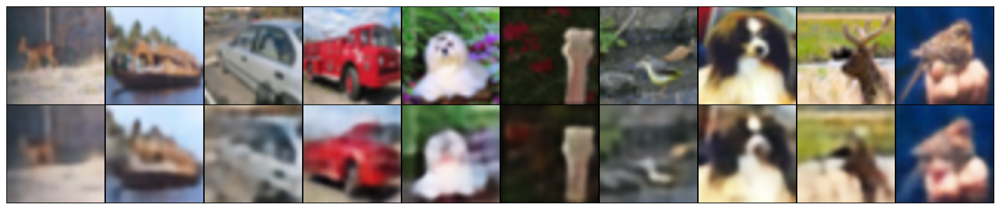

Pixel Error: 3.074928931891918%


In [16]:
# Test our proposed model's MSE on CIFAR-10
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()


data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Pass the images through the model
recon_batch, _, _, _, _ = models[best_model_idx](selected_data)

# Calculate MSE
mse_loss = calculate_mse(selected_data, recon_batch)
print(f'MSE Loss: {mse_loss}')

# Plot the original and reconstructed images
plot_images(selected_data.cpu(), recon_batch.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, recon_batch)
print(f'Pixel Error: {pixel_error}%')


Files already downloaded and verified
Files already downloaded and verified


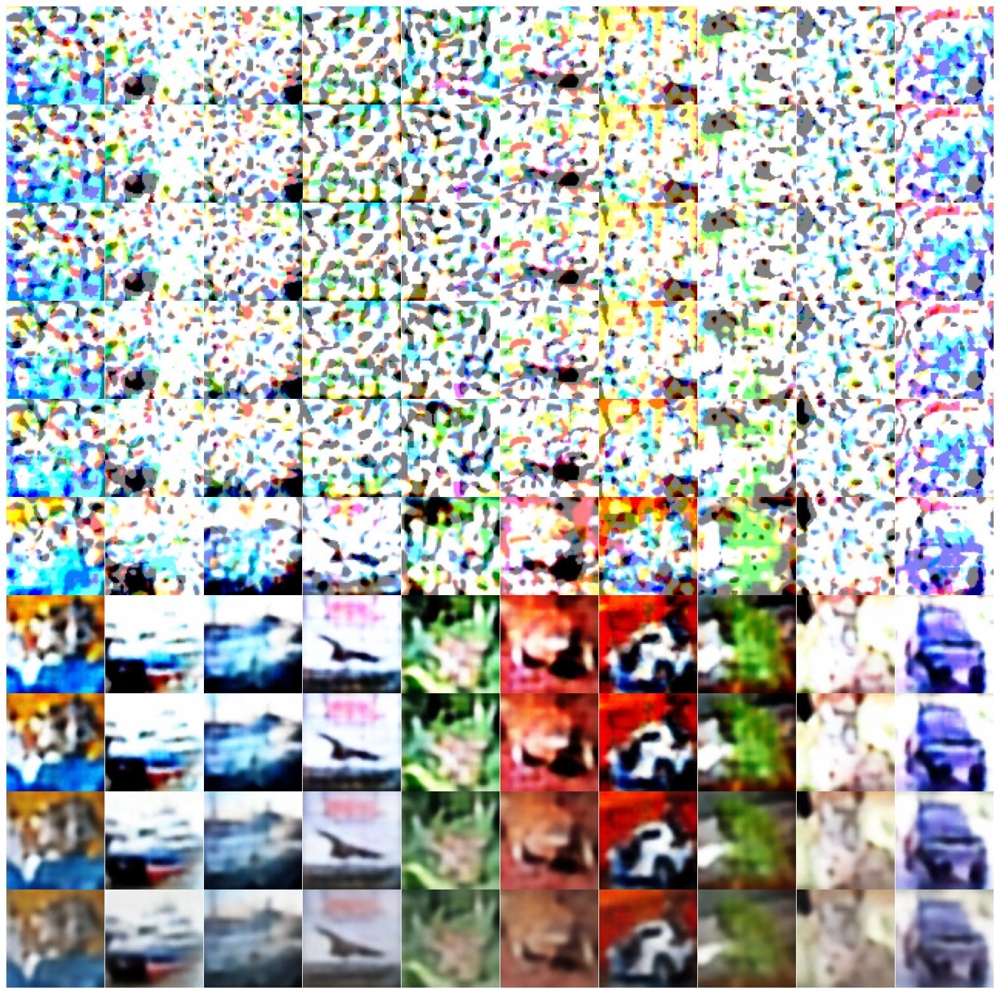

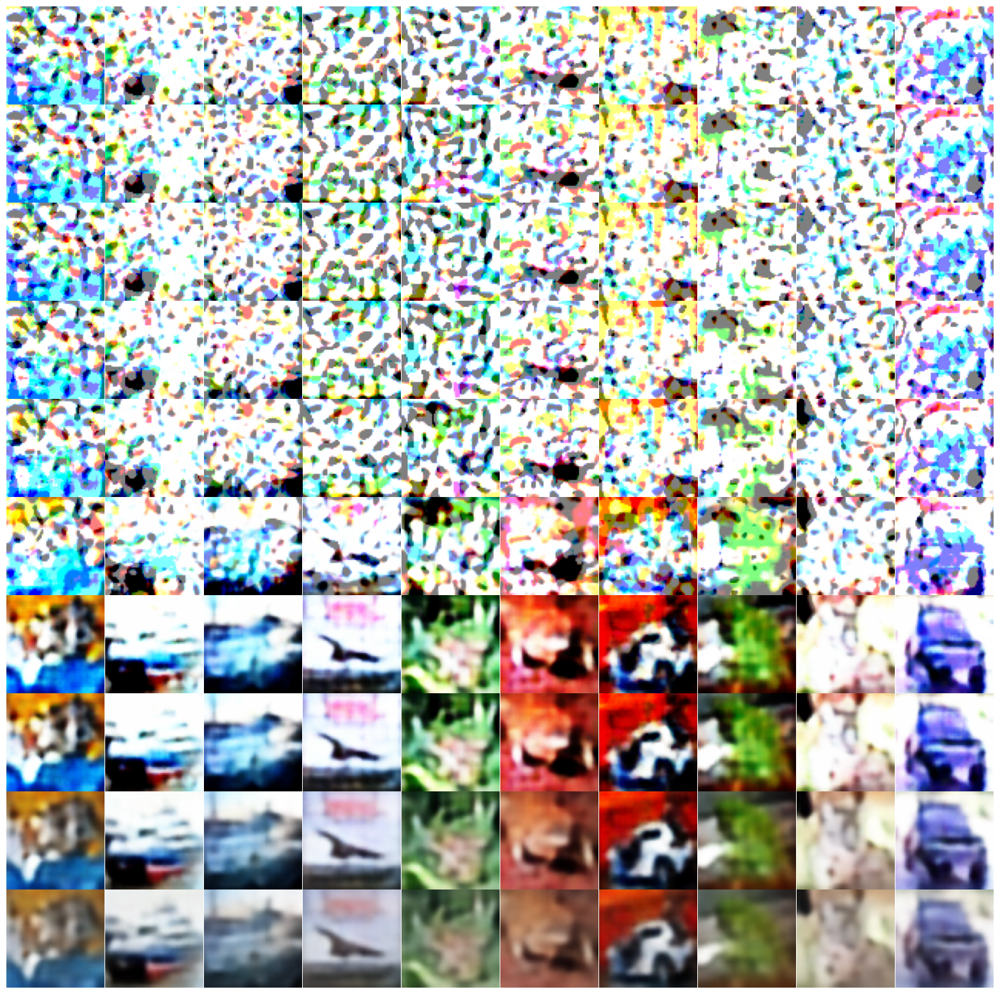

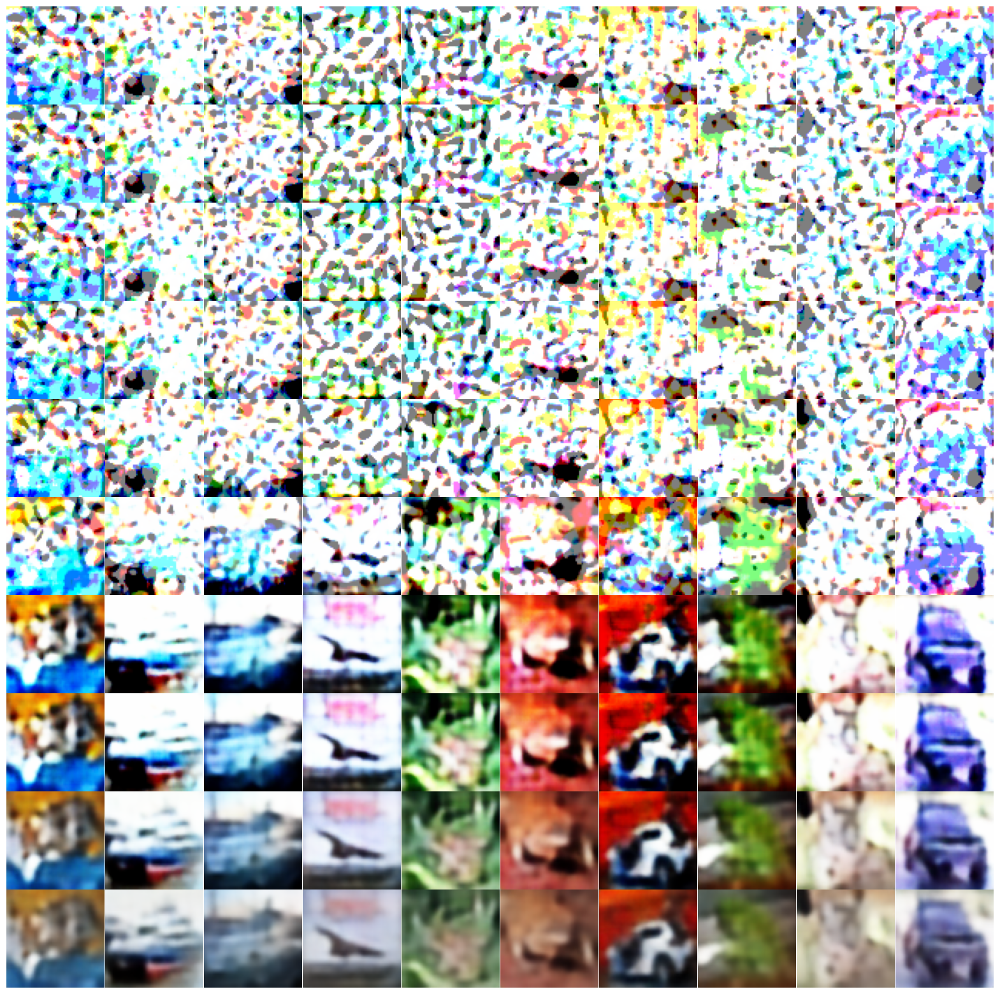

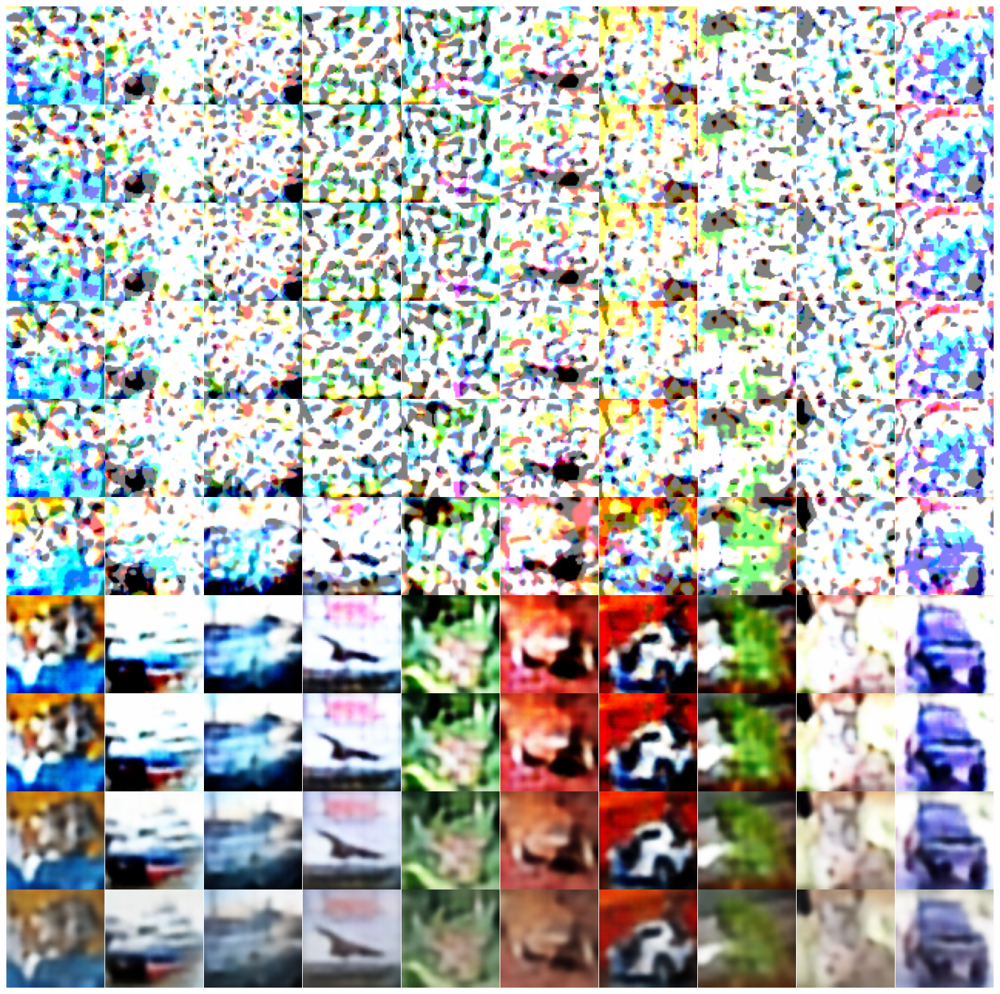

KeyboardInterrupt: 

Error in callback <function flush_figures at 0x78215ea64550> (for post_execute):


KeyboardInterrupt: 

In [4]:
# Observe the impact of temperature on the model trained by parallel framework
# All submodels adopt the linear increasing temperature strategys with diffrent changing rates
import torch
import matplotlib.pyplot as plt
from torchvision import datasets, transforms


# Function to plot reconstructed images in one large figure
def plot_all_reconstructed_images(tau_values, test_loader, model, device, n=10):
    fig, axes = plt.subplots(len(tau_values), n, figsize=(20, 2 * len(tau_values)))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots

    for row, tau in enumerate(tau_values):
        model.tau_1 = tau
        model.tau_2 = tau
        data, _ = next(iter(test_loader))
        data = data.to(device)
        recon_batch, _, _, _, _ = model(data)
        reconstructed_images = recon_batch.cpu().detach().numpy()

        for col in range(n):
            ax = axes[row, col]
            ax.imshow(np.transpose(reconstructed_images[col], (1, 2, 0)))
            ax.axis('off')  # Hide axes

    plt.show()


# Load GumbelSoftmaxVAE model
model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)
model.to(device)
model.eval()

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


# Tau values to test
tau_values = [0.5, 0.9, 0.95, 5, 10, 30, 98.901, 120, 200, 300]

# Iterate over tau values, update model, and plot reconstructed images
for tau in tau_values:
    model.tau_1 = tau
    model.tau_2 = tau
    data, _ = next(iter(test_loader))
    data = data.to(device)
    recon_batch, _, _, _, _ = model(data)
     # Only plot reconstructed images
    plot_all_reconstructed_images(tau_values, test_loader, model, device)


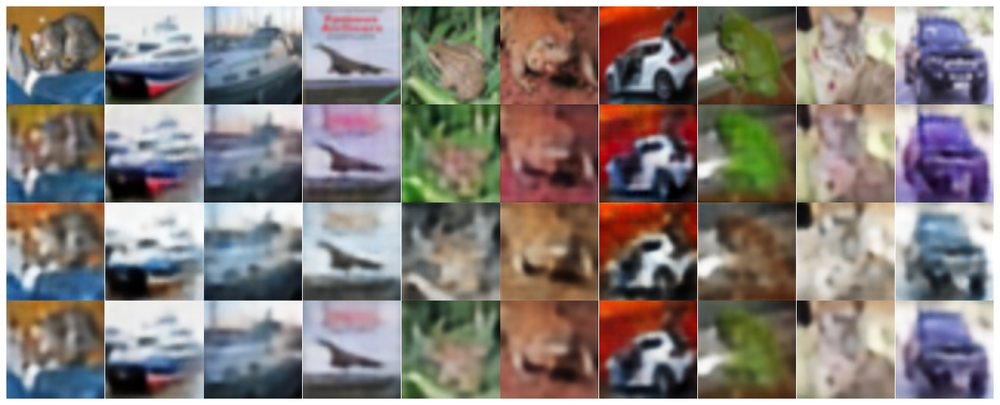

In [5]:
# The GS-VAE model was trained by the full dataset by using parallel temperature adjustment framework
# Test each latent layer's contribution

def plot_images_from_layers_and_reconstruction(data, model):
    with torch.no_grad():  # Ensure we're in no_grad mode when doing inference
        logits_z1, logits_z2 = model.encode(data)
        z1 = model.reparameterize(logits_z1, model.tau_1)
        z2 = model.reparameterize(logits_z2, model.tau_2)
        recon_images_layer1 = model.decode1(z1)
        recon_images_layer2 = model.decode2(z2)
        # Combine the layers to create the final reconstruction
        final_reconstruction = (recon_images_layer1 + recon_images_layer2) / 2.0

        # Plot images
        fig, axes = plt.subplots(4, 10, figsize=(20, 8))
        plt.subplots_adjust(wspace=0, hspace=0)  # Remove whitespace

        for i in range(10):
            # Original images
            axes[0, i].imshow(data[i].cpu().permute(1, 2, 0))
            axes[0, i].axis('off')
            # Reconstructed images from layer 1
            axes[1, i].imshow(recon_images_layer1[i].cpu().permute(1, 2, 0))
            axes[1, i].axis('off')
            # Reconstructed images from layer 2
            axes[2, i].imshow(recon_images_layer2[i].cpu().permute(1, 2, 0))
            axes[2, i].axis('off')
            # Final reconstructed images
            axes[3, i].imshow(final_reconstruction[i].cpu().permute(1, 2, 0))
            axes[3, i].axis('off')

        plt.show()

plot_images_from_layers_and_reconstruction(data, models[best_model_idx])

Files already downloaded and verified
Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.00


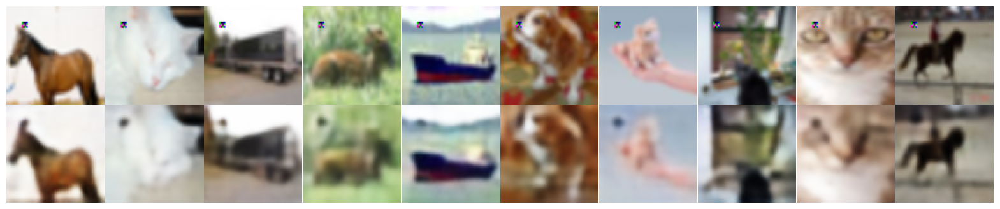

In [17]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation and download CIFAR-10 test dataset
transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

# Function to add Gaussian noise
def add_gaussian_noise(images, mean=0.0, std=0.0):
    return images + torch.randn_like(images) * std + mean

# Function to add an adversarial patch
def add_adversarial_patch(images, patch_size=(4, 4), start_x=10, start_y=10):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))  # Change the order of dimensions
    for img in patched_images:
        img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
    return patched_images

import matplotlib.pyplot as plt
import numpy as np

class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss


# Load the best model
model = GumbelSoftmaxVAE()

state_dict = torch.load('/content/sample_data/best_model_CIFAR10_parallel_laptop1060.pth')

state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)

model.load_state_dict(state_dict)

model.tau_1 = torch.nn.Parameter(torch.tensor(300.0, dtype=torch.float32), requires_grad=True)
model.tau_2 = torch.nn.Parameter(torch.tensor(300.0, dtype=torch.float32), requires_grad=True)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)
model.eval()

def plot_images(original_images, reconstructed_images, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images
        ax = axes[0, i]
        original_img = np.transpose(original_images[i].numpy(), (1, 2, 0))
        ax.imshow(original_img, cmap='gray')
        ax.axis('off')

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = np.transpose(reconstructed_images[i].detach().numpy(), (1, 2, 0))  # Use detach() here
        ax.imshow(recon_img, cmap='gray')
        ax.axis('off')

    plt.show()

# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Add Gaussian noise and adversarial patch
noisy_data = add_gaussian_noise(data)
patched_data = add_adversarial_patch(noisy_data)

# Pass the images through the model
recon_batch = model(patched_data)[0]

# Function to calculate reconstruction error
def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Find the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = np.mean(predicted_anomalies)
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original (patched) and reconstructed images
original_images = patched_data.cpu()
reconstructed_images = recon_batch.cpu()

plot_images(original_images, reconstructed_images, n=10)



Files already downloaded and verified
Files already downloaded and verified
Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.00
Image 1: Patched: No, Predicted: Yes
Image 2: Patched: Yes, Predicted: Yes
Image 3: Patched: No, Predicted: No
Image 4: Patched: Yes, Predicted: Yes
Image 5: Patched: Yes, Predicted: Yes
Image 6: Patched: Yes, Predicted: Yes
Image 7: Patched: Yes, Predicted: Yes
Image 8: Patched: Yes, Predicted: Yes
Image 9: Patched: Yes, Predicted: Yes
Image 10: Patched: No, Predicted: No
Image 11: Patched: No, Predicted: No
Image 12: Patched: Yes, Predicted: Yes
Image 13: Patched: Yes, Predicted: Yes
Image 14: Patched: No, Predicted: No
Image 15: Patched: Yes, Predicted: Yes
Image 16: Patched: No, Predicted: No
Image 17: Patched: Yes, Predicted: Yes
Image 18: Patched: No, Predicted: No
Image 19: Patched: No, Predicted: No
Image 20: Patched: No, Predicted: No
Image 21: Patched: No, Predicted: No
Image 22: Patched: No, Predicted: No
Image 23: Patched: No, Predicted: No
Im

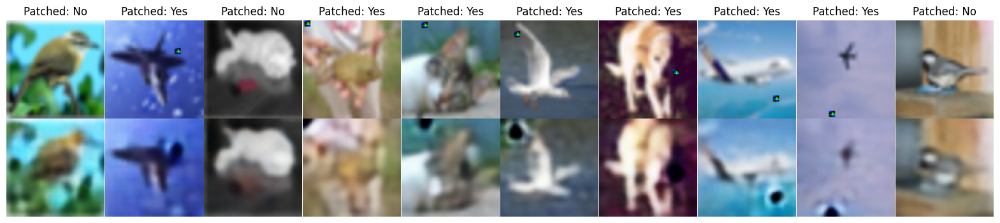

Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.00


In [18]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 50  # Update batch size to 50
device = 'cuda' if torch.cuda.is_available() else 'cpu'

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def add_adversarial_patch(images, patch_size=(4, 4), probability=0.6):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))
    is_patched = np.zeros(len(images), dtype=bool)
    for idx, img in enumerate(patched_images):
        if np.random.rand() < probability:
            start_x = np.random.randint(0, img.shape[2] - patch_size[1])
            start_y = np.random.randint(0, img.shape[1] - patch_size[0])
            img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
            is_patched[idx] = True
    return patched_images, is_patched

data, _ = next(iter(test_loader))
data = data.to(device)

patched_data, is_patched = add_adversarial_patch(data)

recon_batch, _, _, _, _ = model(patched_data)

def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Determine the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = (predicted_anomalies == is_patched).mean()
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original and reconstructed images
def plot_images_with_labels(original_images, reconstructed_images, labels, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images with labels
        ax = axes[0, i]
        original_img = original_images[i].cpu().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(original_img, (1, 2, 0)))
        ax.axis('off')
        label_text = 'Yes' if labels[i] else 'No'
        ax.set_title(f"Patched: {label_text}")

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = reconstructed_images[i].cpu().detach().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(recon_img, (1, 2, 0)))
        ax.axis('off')

    plt.show()

# Print whether the image was patched and the model's prediction
for i in range(50):
    actual = 'Yes' if is_patched[i] else 'No'
    predicted = 'Yes' if reconstruction_errors[i] > best_threshold else 'No'
    print(f"Image {i+1}: Patched: {actual}, Predicted: {predicted}")

# Plot images and labels for the first 10 instances
plot_images_with_labels(patched_data[:10], recon_batch[:10], is_patched[:10], n=10)
# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

MSE Loss: 0.003199017606675625


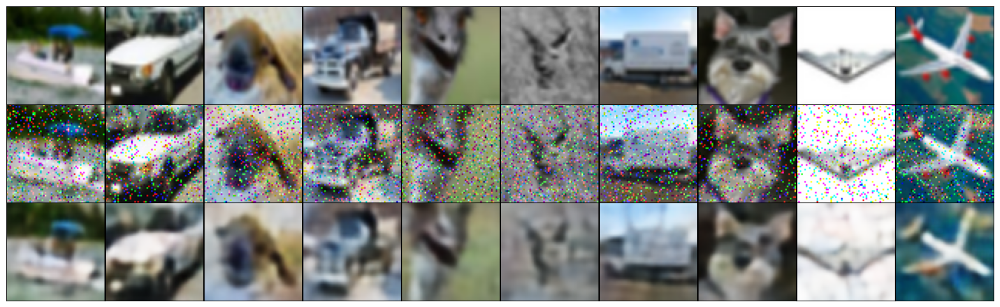

Pixel Error: 4.334915429353714%


In [28]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply salt and pepper noise
def salt_and_pepper_noise(image, prob):
    output = np.copy(image)
    salt_pepper = np.random.rand(*image.shape[:2])
    salt = salt_pepper < prob / 2
    pepper = salt_pepper > 1 - prob / 2
    output[salt] = 1
    output[pepper] = 0
    return output

# Convert torch tensor to numpy array, apply noise, then convert back to tensor
def apply_salt_and_pepper(tensor, prob):
    np_tensor = tensor.cpu().numpy()
    noisy_tensor = np.zeros_like(np_tensor)
    for i in range(np_tensor.shape[0]):
        for c in range(np_tensor.shape[1]):
            noisy_tensor[i, c] = salt_and_pepper_noise(np_tensor[i, c], prob)
    return torch.tensor(noisy_tensor).to(tensor.device)

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply salt and pepper noise
attacked_data = apply_salt_and_pepper(selected_data, 0.1)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')


MSE Loss: 0.0020853534806519747


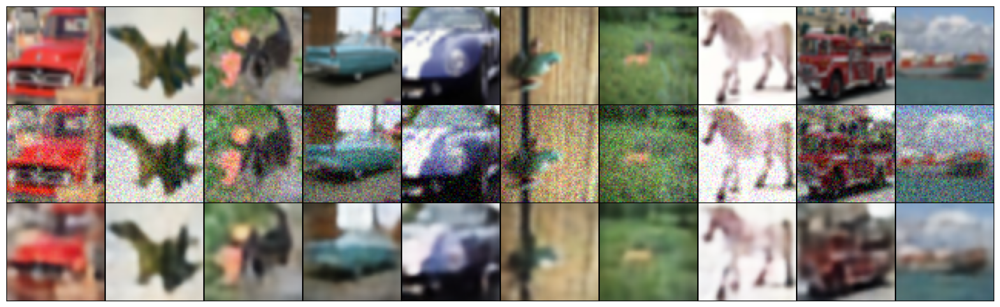

Pixel Error: 3.3877380192279816%


In [34]:
# Test the reconstruction of GS-VAE model was trained by full dataset by using parallel framework (using different changing rate with model 1)
# The original images are attacked by high-intensity Gaussian noise
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply Gaussian noise
def gaussian_noise(image, mean=0, std=0.5):
    noise = np.random.normal(mean, std, image.shape)
    noisy_image = image + noise
    noisy_image = np.clip(noisy_image, 0, 1)  # Ensure pixel values are within [0, 1]
    return noisy_image

# Convert torch tensor to numpy array, apply noise, then convert back to tensor
def apply_gaussian_noise(tensor, mean=0, std=0.1):
    np_tensor = tensor.cpu().numpy()
    noisy_tensor = np.zeros_like(np_tensor)
    for i in range(np_tensor.shape[0]):
        noisy_tensor[i] = gaussian_noise(np_tensor[i], mean, std)
    return torch.tensor(noisy_tensor).to(tensor.device)

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply Gaussian noise
attacked_data = apply_gaussian_noise(selected_data, mean=0, std=0.1)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')



MSE Loss: 0.0051874155178666115


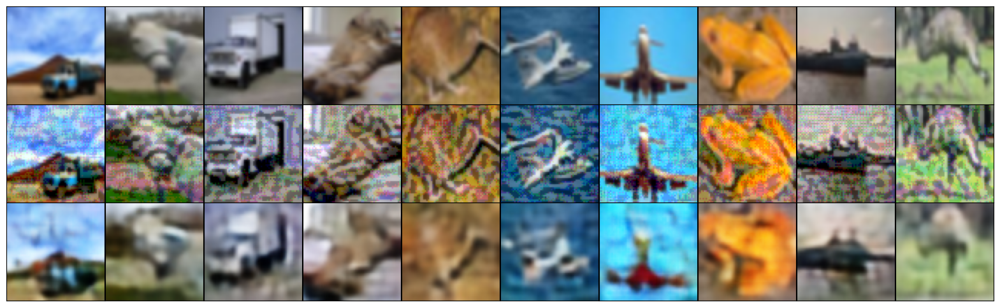

Pixel Error: 5.419465154409409%


In [39]:
# Test our model for reconstructing the images attacked by high-intensity FGSM attacks
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().detach().numpy()  # Use detach() here
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply FGSM attack based on MSE loss
def fgsm_attack(model, images, epsilon):
    images = images.clone().detach().to(device)
    images.requires_grad = True

    recon_images = model(images)
    recon_images = recon_images[0] if isinstance(recon_images, tuple) else recon_images  # Extract the prediction if it's a tuple

    loss = F.mse_loss(recon_images, images)

    model.zero_grad()
    loss.backward()
    data_grad = images.grad.data

    sign_data_grad = data_grad.sign()
    perturbed_images = images + epsilon * sign_data_grad
    perturbed_images = torch.clamp(perturbed_images, 0, 1)
    return perturbed_images

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply FGSM attack
epsilon = 0.1
attacked_data = fgsm_attack(model, selected_data, epsilon)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')


MSE Loss: 0.0034339181147515774


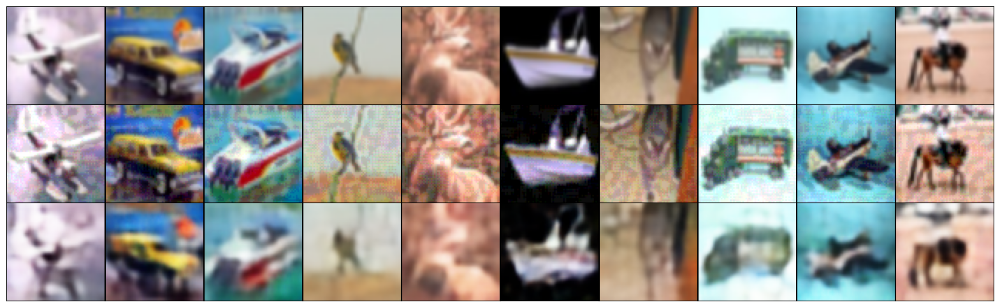

Pixel Error: 4.226471111178398%


In [40]:
# Test our model for reconstructing the images attacked by high-intensity FGSM attacks
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().detach().numpy()  # Use detach() here
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply FGSM attack based on MSE loss
def fgsm_attack(model, images, epsilon):
    images = images.clone().detach().to(device)
    images.requires_grad = True

    recon_images = model(images)
    recon_images = recon_images[0] if isinstance(recon_images, tuple) else recon_images  # Extract the prediction if it's a tuple

    loss = F.mse_loss(recon_images, images)

    model.zero_grad()
    loss.backward()
    data_grad = images.grad.data

    sign_data_grad = data_grad.sign()
    perturbed_images = images + epsilon * sign_data_grad
    perturbed_images = torch.clamp(perturbed_images, 0, 1)
    return perturbed_images

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply FGSM attack
epsilon = 0.05
attacked_data = fgsm_attack(model, selected_data, epsilon)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')


MSE Loss: 0.01210722979158163


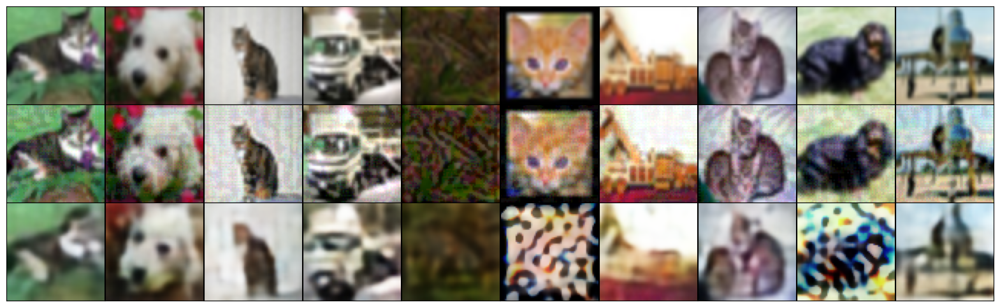

Pixel Error: 6.9420866668224335%


In [42]:
# Test our model for reconstructing the images attacked by high-intensity PGD attacks
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().detach().numpy()  # Use detach() here
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply PGD attack
def pgd_attack(model, images, epsilon, alpha, iters):
    images = images.clone().detach().to(device)
    original_images = images.clone().detach()
    images.requires_grad = True

    for _ in range(iters):
        recon_images = model(images)
        recon_images = recon_images[0] if isinstance(recon_images, tuple) else recon_images  # Extract the prediction if it's a tuple

        loss = F.mse_loss(recon_images, images)

        model.zero_grad()
        loss.backward()
        data_grad = images.grad.data

        perturbed_images = images + alpha * data_grad.sign()
        eta = torch.clamp(perturbed_images - original_images, min=-epsilon, max=epsilon)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad = True

    return images

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply PGD attack
epsilon = 0.05
alpha = 0.01
iters = 40
attacked_data = pgd_attack(model, selected_data, epsilon, alpha, iters)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')


MSE Loss: 0.03106154315173626


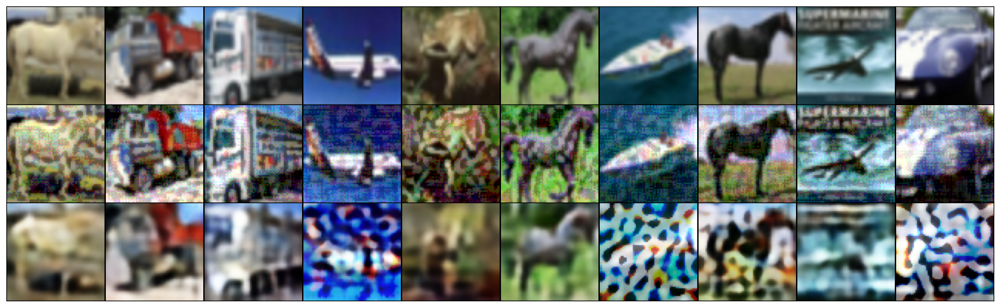

Pixel Error: 12.322244048118591%


In [ ]:
# Test our model for reconstructing the images attacked by high-intensity PGD attacks
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, attacked_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    attacked_images_np = attacked_images.cpu().detach().numpy()  # Use detach() here
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 6))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot attacked images
        ax = plt.subplot(3, n, i + n + 1)
        plt.imshow(np.transpose(attacked_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(3, n, i + 2 * n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to apply PGD attack
def pgd_attack(model, images, epsilon, alpha, iters):
    images = images.clone().detach().to(device)
    original_images = images.clone().detach()
    images.requires_grad = True

    for _ in range(iters):
        recon_images = model(images)
        recon_images = recon_images[0] if isinstance(recon_images, tuple) else recon_images  # Extract the prediction if it's a tuple

        loss = F.mse_loss(recon_images, images)

        model.zero_grad()
        loss.backward()
        data_grad = images.grad.data

        perturbed_images = images + alpha * data_grad.sign()
        eta = torch.clamp(perturbed_images - original_images, min=-epsilon, max=epsilon)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad = True

    return images

# Load test data
data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Apply PGD attack
epsilon = 0.1
alpha = 0.01
iters = 40
attacked_data = pgd_attack(model, selected_data, epsilon, alpha, iters)

# Pass the attacked images through the model
recon_batch = model(attacked_data)

# Extract the reconstruction from the model's output
reconstructed_images = recon_batch[0] if isinstance(recon_batch, tuple) else recon_batch

# Calculate MSE
mse_loss = calculate_mse(selected_data, reconstructed_images)
print(f'MSE Loss: {mse_loss}')

# Plot the original, attacked, and reconstructed images
plot_images(selected_data.cpu(), attacked_data.cpu(), reconstructed_images.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, reconstructed_images)
print(f'Pixel Error: {pixel_error}%')
